<a href="https://colab.research.google.com/github/williamzhao01123/crypto-lab/blob/master/EIP_1559_William_Zhao.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Note:** **This Colab is for collaborating projects by the following authors (in alphabetical order of the last name)**

preliminary result: please don't cite or distribute

Yulin Liu: yulin@bochslerfinance.com 


Kartik Nayak:kartik@cs.duke.edu 

Fan Zhang: fanz@cs.duke.edu

Luyao Zhang: lz183@duke.edu

Yinhong Zhao: yinhong.zhao@duke.edu

# Import Data and Packages

In [ ]:
#@title import pandas and numpy
import pandas as pd
import numpy as np


In [ ]:
#Mount drive and copy path of the input data
from google.colab import drive
drive.mount('/content/drive')
print('Authenticated')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Authenticated


# Merge Data

In [ ]:
aggregated = pd.read_csv("/content/drive/MyDrive/EIP-1559/EIP-1559 Data/aggregated.csv")
block = pd.read_csv("/content/drive/MyDrive/EIP-1559/EIP-1559 Data/block.csv")
price = pd.read_csv("/content/drive/MyDrive/EIP-1559/EIP-1559 Data/ETHprice21Aug.csv")
MEV = pd.read_csv("/content/drive/MyDrive/EIP-1559/EIP-1559 Data/MEVdata.csv")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
price = pd.read_csv('/content/drive/My Drive/EIP-1559/EIP-1559 Data/ETHprice21Aug.csv').reset_index(drop=True)
price['minute'] = pd.to_datetime(price['Date']).dt.tz_localize('US/Eastern').dt.tz_convert('UTC')
price = price.drop(['Date'], axis=1).sort_values('minute').reset_index(drop = True)
price['HML'] = np.log(price['High']) - np.log(price['Low'])
price['OMC'] = abs(np.log(price['Close']) - np.log(price['Open']))
price['volatility'] = np.sqrt(60) * price['HML'].rolling(window=60).mean()
price['volatility2'] = np.sqrt(60) * price['OMC'].rolling(window=60).mean()

In [ ]:
df = pd.merge(aggregated, block, on="block_number", how= "left")
df['BQ_timestamp'] = pd.to_datetime(df['BQ_timestamp'])
df['minute'] = df.BQ_timestamp.dt.floor(freq="T")

df = pd.merge(df, price, on="minute", how = "left")
df["base_fee"] = df["base_fee"] / 10**9

In [ ]:
df.head()

,block_number,wtq05,wtq25,wtq50,wtq75,wtq95,wtcount,_wtq05,_wtq25,_wtq50,_wtq75,_wtq95,_wtcount,gpq05,gpq25,gpq50,gpq75,gpq95,gpcount,mfq05,mfq25,mfq50,mfq75,mfq95,mfcount,prq05,prq25,prq50,prq75,prq95,prcount,BQ_timestamp,block_hash,sha3_uncles,miner,difficulty,size,gas_limit,gas_used,tr_count,base_fee,minute,Open,High,Low,Close,HML,OMC,volatility,volatility2
0,12910001,1.972822,6.055621,12.226585,30.169318,42.807994,173,1.972822,6.055621,12.226585,30.169318,42.807994,173,27.36,28.000001,29.0,32.000000,45.000000,173,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,0,2021-07-27 19:42:43+00:00,0x0058748bfda1b9376c00a255bf4d24aa213bc6f3e79c...,0x1dcc4de8dec75d7aab85b567b6ccd41ad312451b948a...,0x829bd824b016326a401d083b33d092293333a830,7.165400e+15,57898,14999986,14979042,173,NaN,2021-07-27 19:42:00+00:00,2241.383,2241.383,2238.579,2239.782,0.001252,0.000715,0.010216,0.005417
1,12910002,9.636821,19.868118,24.172505,37.762288,45.825213,211,7.868438,18.216203,23.576235,37.314291,45.746408,220,31.90,33.750000,36.0,55.000000,68.028571,220,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,0,2021-07-27 19:42:44+00:00,0x936814ac221d09d967e32241bf7ae649e105a1e3cdeb...,0x1dcc4de8dec75d7aab85b567b6ccd41ad312451b948a...,0x5a0b54d5dc17e0aadc383d2db43b0a0d3e029c4c,7.169030e+15,67676,15000000,14979751,220,NaN,2021-07-27 19:42:00+00:00,2241.383,2241.383,2238.579,2239.782,0.001252,0.000715,0.010216,0.005417
2,12910003,2.948548,8.552991,23.045395,39.750798,48.139340,182,2.393464,7.923201,21.599715,39.257876,48.129051,187,28.00,29.000000,30.0,31.000000,36.000000,187,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,0,2021-07-27 19:43:31+00:00,0x69a8694ac5c45abd30e0a6729bab24b3e2df735ab44a...,0x1dcc4de8dec75d7aab85b567b6ccd41ad312451b948a...,0xe206e3dca498258f1b7eec1c640b5aee7bb88fd0,7.155170e+15,68656,15000000,14986125,187,NaN,2021-07-27 19:43:00+00:00,2239.788,2242.830,2239.742,2242.830,0.001378,0.001357,0.010291,0.005542
3,12910004,2.536656,5.144359,12.590089,64.849206,101.030025,170,2.134394,4.981872,10.672975,63.093307,100.987313,175,26.00,27.000000,27.5,31.950000,40.535000,175,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,0,2021-07-27 19:43:35+00:00,0x8eccce2f2ef2a3165c9853dacb963037776525aa4615...,0x322b2ef827d6b209ced7b3a3f3cf5c6cc17a477ac92e...,0x5a0b54d5dc17e0aadc383d2db43b0a0d3e029c4c,7.158800e+15,54915,15000000,14984700,175,NaN,2021-07-27 19:43:00+00:00,2239.788,2242.830,2239.742,2242.830,0.001378,0.001357,0.010291,0.005542
4,12910005,6.835902,11.133770,15.546269,78.573798,90.579967,168,6.835902,11.133770,15.546269,78.573798,90.579967,168,26.00,26.000000,28.6,34.025001,43.750000,168,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,0,2021-07-27 19:43:41+00:00,0x81f12d5a6549b69018f3d4e8101a633d2c91e70e2f32...,0x1dcc4de8dec75d7aab85b567b6ccd41ad312451b948a...,0xbcc817f057950b0df41206c5d7125e6225cae18e,7.165930e+15,44366,14985353,14977849,168,NaN,2021-07-27 19:43:00+00:00,2239.788,2242.830,2239.742,2242.830,0.001378,0.001357,0.010291,0.005542


# Visualization

In [ ]:
# Import Plotly Packages
### 
import plotly.express as px
import plotly.offline as py     
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

## Block Data

In [ ]:
#Time Series for Block Gas Limit and Block Gas Used
trace0 = go.Scatter(x = df["number"], y = df["used"], hoverinfo='x+y', mode='markers',  name = 'Block Gas Used', marker=dict(size=0.5))
trace1 = go.Scatter(x = df["number"], y = df["limit"], hoverinfo='x+y', mode='lines',  name = 'Block Gas Limit', marker=dict(size=0.5))

layout = go.Layout(title="Timeseries for Block Gas Limit and Block Gas Used ", xaxis = dict(title="block"), yaxis = dict(title ="Gas") ) 
data = [trace1, trace0]
fig_used = go.Figure(layout = layout, data = data) 
fig_used = fig_used.add_trace(go.Scatter(x=[12965000, 12965000], y=[0, 30], mode="lines", name="London Hard Fork"))
fig_used.show()

In [ ]:
df_after = df[df["block_number"] > 12965000]
df_after = df_after[df_after["gas_used"] < 30000000]
fig_size = px.histogram(df_after, x="gas_used", nbins=50, histnorm="percent")
fig_size.update_layout(yaxis_title = "percent")
fig_size.show()

In [ ]:
df["usage"] = df["mfcount"]/df["gpcount"]
trace = go.Scatter(x = df["block_number"], y = df["usage"], hoverinfo='x+y', mode='markers', name = 'Adoption rate', marker=dict(size=1))

layout = go.Layout(title="Timeseries for EIP-1559 Bidding Adoption Rate", xaxis = dict(title="block"), yaxis = dict(title ="Adoption rate") ) 
data = [trace]

fig_adoption = go.Figure(layout = layout, data = data) 
fig_adoption.add_trace(go.Scatter(x=[12965000, 12965000], y=[0,1], mode="lines", name="London Hard Fork"))
fig_adoption.show()

## Block Transaction Data

In [ ]:
df_basefee = df[df["basefee"] < 200]
trace = go.Scatter(x = df_basefee["number"], y = df_basefee["basefee"], hoverinfo='x+y', mode='markers', name = 'Base Fee', marker=dict(size=1))

layout = go.Layout(title="Timeseries for Base Fee", xaxis = dict(title="block"), yaxis = dict(title ="base fee") ) 
data = [trace]

fig_basefee = go.Figure(layout = layout, data = data) 
fig_basefee.add_trace(go.Scatter(x=[12965000, 12965000], y=[0,200], mode="lines", name="London Hard Fork"))
fig_basefee.show()

In [ ]:
df_gp = df[df['gpq95'] < 200]
trace1 = go.Scatter(x = df_gp["block_number"], y = df_gp["gpq05"], hoverinfo='x+y', mode='markers',  name = '5% quartile actual gas price paid', marker=dict(size=0.1))
trace2 = go.Scatter(x = df_gp["block_number"], y = df_gp["gpq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile actual gas price paid', marker=dict(size=0.1))
trace3 = go.Scatter(x = df_gp["block_number"], y = df_gp["gpq95"], hoverinfo='x+y', mode='markers',  name = '95% quartile actual gas price paid', marker=dict(size=0.1))

layout = go.Layout(title="Timeseries for Gas Price Paid Quantiles ", xaxis = dict(title="block"), yaxis = dict(title ="Gas pricd paid per gas") ) 
data = [trace1, trace2, trace3]

fig_gp = go.Figure(layout = layout, data = data) 
fig_gp.add_trace(go.Scatter(x=[12965000, 12965000], y=[0,200], mode="lines", name="London Hard Fork"))
fig_gp.show()

In [ ]:
#Time Series for Inter-quartile Difference of Gas Price
df["iqdiff"] = (df["gpq75"]-df["gpq25"])/df["gpq50"]
df_iq = df[df["iqdiff"]<1]

trace = go.Scatter(x = df_iq["block_number"], y = df_iq["iqdiff"], hoverinfo='x+y', mode='markers',  name = 'Within-block inter-quartile difference', marker=dict(size=1))

layout = go.Layout(title="Within-block inter-quartile difference of gas price", xaxis = dict(title="block"), yaxis = dict(title ="iqdiff") ) 
data = [trace]

fig_gp = go.Figure(layout = layout, data = data) 
fig_gp.add_trace(go.Scatter(x=[12965000, 12965000], y=[0,1], mode="lines", name="London Hard Fork"))
fig_gp.show()

In [ ]:
# Priority Fee Paid Distribution
df_apr = df[df["block_number"] > 12965000]
df_apr["aprq05"] = df_apr["gpq05"] - df_apr["base_fee"]
df_apr["aprq25"] = df_apr["gpq25"] - df_apr["base_fee"]
df_apr["aprq50"] = df_apr["gpq50"] - df_apr["base_fee"]
df_apr["aprq75"] = df_apr["gpq75"] - df_apr["base_fee"]
df_apr["aprq95"] = df_apr["gpq95"] - df_apr["base_fee"]
df_apr = df_apr[df_apr["aprq75"] < 50]

trace0 = go.Scatter(x = df_apr["block_number"], y = df_apr["aprq25"], hoverinfo='x+y', mode='markers', name = '25% quartile actual priority fee paid', marker=dict(size=1))
trace2 = go.Scatter(x = df_apr["block_number"], y = df_apr["aprq50"], hoverinfo='x+y', mode='markers', name = '50% quartile actual priority fee paid', marker=dict(size=1))
trace4 = go.Scatter(x = df_apr["block_number"], y = df_apr["aprq75"], hoverinfo='x+y', mode='markers', name = '75% quartile actual priority fee paid', marker=dict(size=1))

layout = go.Layout(title="Timeseries for Priority Fee Paid", xaxis = dict(title="block"), yaxis = dict(title ="Priority Fee Paid") ) 
data = [trace0, trace2, trace4]

fig7 = go.Figure(layout = layout, data = data) 
fig7.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
#Priority Fee Bid Distribution
df_after = df[df["block_number"]>12965000]
df_pr = df_after[df["prq75"] < 50]

trace1 = go.Scatter(x = df_pr["block_number"], y = df_pr["prq25"], hoverinfo='x+y', mode='markers',  name = '25% quartile actual priority fee bid', marker=dict(size=1))
trace2 = go.Scatter(x = df_pr["block_number"], y = df_pr["prq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile actual priority fee bid', marker=dict(size=1))
trace3 = go.Scatter(x = df_pr["block_number"], y = df_pr["prq75"], hoverinfo='x+y', mode='markers',  name = '75% quartile actual priority fee bid', marker=dict(size=1))

layout = go.Layout(title="Timeseries for Priority Fee Bid ", xaxis = dict(title="block"), yaxis = dict(title ="Priority Fee bid") ) 
data = [trace1, trace2, trace3]

fig8 = go.Figure(layout = layout, data = data) 
fig8.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [ ]:
#Max Fee Bid Distribution
df_after = df[df["block_number"]>12965000]
df_mf = df_after[df["mfq75"] < 200]

trace1 = go.Scatter(x = df_mf["block_number"], y = df_mf["mfq25"], hoverinfo='x+y', mode='markers',  name = '25% quartile max fee bid', marker=dict(size=1))
trace2 = go.Scatter(x = df_mf["block_number"], y = df_mf["mfq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile max fee bid', marker=dict(size=1))
trace3 = go.Scatter(x = df_mf["block_number"], y = df_mf["mfq75"], hoverinfo='x+y', mode='markers',  name = '75% quartile max fee bid', marker=dict(size=1))

layout = go.Layout(title="Timeseries for Max Fee Bid ", xaxis = dict(title="block"), yaxis = dict(title ="Priority Fee bid") ) 
data = [trace1, trace2, trace3]

fig9 = go.Figure(layout = layout, data = data) 
fig9.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [ ]:
#Max Fee Bid Distribution
df_after = df[df["block_number"]>12965000]
df_all = df_after[df_after["gpq50"] < 250]
df_all = df_all[df_all["mfq50"] < 250]
df_all["aprq50"] = df_all["gpq50"] - df_all["base_fee"]
df_all = df_all[df_all["prq50"] < 250]
df_all = df_all[df_all["aprq50"] < 250]
df_all = df_all[df_all["base_fee"] < 250]

trace1 = go.Scatter(x = df_all["block_number"], y = df_all["gpq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile gas price paid', marker=dict(size=1))
trace2 = go.Scatter(x = df_all["block_number"], y = df_all["mfq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile max fee bid', marker=dict(size=1))
trace3 = go.Scatter(x = df_all["block_number"], y = df_all["prq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile priority fee bid', marker=dict(size=1))
trace4 = go.Scatter(x = df_all["block_number"], y = df_all["aprq50"], hoverinfo='x+y', mode='markers',  name = '50% quartile priority fee paid', marker=dict(size=1))
trace5 = go.Scatter(x = df_all["block_number"], y = df_all["base_fee"], hoverinfo='x+y', mode='markers',  name = 'base fee', marker=dict(size=1))

layout = go.Layout(title="Timeseries for Fee Dynamics ", xaxis = dict(title="block"), yaxis = dict(title ="Gas Price (Gwei)") ) 
data = [trace1, trace2, trace3, trace4, trace5]

fig10 = go.Figure(layout = layout, data = data) 
fig10.show()

# Statistic Tests

## The Dickey-Fuller test for stationary
Null hypothesis:not stationary

https://machinelearningmastery.com/time-series-data-stationary-python/

In [ ]:
df.columns

Index(['timestamp', 'number', 'size', 'limit', 'used', 'tr_count', 'basefee',
       'prq05', 'prq25', 'prq50', 'prq75', 'prq95', 'prcount', 'gpq05',
       'gpq25', 'gpq50', 'gpq75', 'gpq95', 'gpcount', 'mfq05', 'mfq25',
       'mfq50', 'mfq75', 'mfq95', 'mfcount', 'minute', 'EIP', 'usage', 'hour',
       'aprq05', 'aprq25', 'aprq50', 'aprq75', 'aprq95', 'iqdiff', 'open',
       'high', 'low', 'close', 'hml', 'volatility', 'limit_adjusted'],
      dtype='object')

In [ ]:
s=df['used'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -91.070323
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['basefee'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -24.769682
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['usage'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -4.821926
p-value: 0.000049
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['iqdiff'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -31.734218
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['volatility'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -9.540985
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['size'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -24.838752
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['limit'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -2.090753
p-value: 0.248249
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['used'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -91.070323
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['open'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.908375
p-value: 0.785202
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['close'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.885513
p-value: 0.792706
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['high'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.930447
p-value: 0.777781
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['low'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.886443
p-value: 0.792404
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['Open_Growrate'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -44.728218
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['Close_Growrate'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -44.926746
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['High_Growrate'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -44.625182
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [ ]:
s=df['Low_Growrate'].dropna()
from statsmodels.tsa.stattools import adfuller
result = adfuller(s)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -49.637936
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


## Correlation test

In [ ]:
#@title Data Path
data_path = "/content/drive/MyDrive/EIP-1559/EIP-1559 Data/EIP1559.csv" #@param {type:"string"}


In [ ]:
df.to_csv(data_path, index=False)

In [ ]:
df = pd.read_csv(data_path)
df.head()

,timestamp,number,size,limit,used,tr_count,basefee,prq05,prq25,prq50,prq75,prq95,prcount,gpq05,gpq25,gpq50,gpq75,gpq95,gpcount,mfq05,mfq25,mfq50,mfq75,mfq95,mfcount,minute,EIP,usage,hour,aprq05,aprq25,aprq50,aprq75,aprq95,iqdiff,open,high,low,close,hml,volatility,Open_Growrate,Close_Growrate,High_Growrate,Low_Growrate,limit_adjusted
0,2021-08-01 00:00:17,12936340,79706,14978011,14.972452,161,0.0,NaN,NaN,NaN,NaN,NaN,0,30.0,31.50028,35.000000,42.0,464.000000,161,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:00,0,0.0,0,30.0,31.50028,35.000000,42.000000,464.00000,0.299992,2532.7229,2534.7129,2531.1631,2532.988,0.001401,NaN,NaN,NaN,NaN,NaN,14.978011
1,2021-08-01 00:01:00,12936341,69444,14963386,14.944270,248,0.0,NaN,NaN,NaN,NaN,NaN,0,28.0,29.00000,29.000000,30.0,30.000000,248,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,28.0,29.00000,29.000000,30.000000,30.00000,0.034483,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,0.000091,-0.003071,-0.000534,-0.002852,14.963386
2,2021-08-01 00:01:07,12936342,61130,14970666,14.969808,181,0.0,NaN,NaN,NaN,NaN,NaN,0,33.0,35.00000,40.000000,55.8,194.000000,181,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,33.0,35.00000,40.000000,55.799999,194.00000,0.520000,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,0.000000,0.000000,0.000000,0.000000,14.970666
3,2021-08-01 00:01:34,12936343,72519,14985284,14.964785,157,0.0,NaN,NaN,NaN,NaN,NaN,0,30.0,31.00000,35.000000,40.0,174.290000,157,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,30.0,31.00000,35.000000,40.000000,174.28999,0.257143,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,0.000000,0.000000,0.000000,0.000000,14.985284
4,2021-08-01 00:01:57,12936344,59521,14970651,14.967183,177,0.0,NaN,NaN,NaN,NaN,NaN,0,35.0,36.00000,39.992858,54.0,83.496907,177,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,35.0,36.00000,39.992859,54.000000,83.49691,0.450080,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,0.000000,0.000000,0.000000,0.000000,14.970651


In [ ]:
df.columns

Index(['timestamp', 'number', 'size', 'limit', 'used', 'tr_count', 'basefee',
       'prq05', 'prq25', 'prq50', 'prq75', 'prq95', 'prcount', 'gpq05',
       'gpq25', 'gpq50', 'gpq75', 'gpq95', 'gpcount', 'mfq05', 'mfq25',
       'mfq50', 'mfq75', 'mfq95', 'mfcount', 'minute', 'EIP', 'usage', 'hour',
       'aprq05', 'aprq25', 'aprq50', 'aprq75', 'aprq95', 'iqdiff', 'open',
       'high', 'low', 'close', 'hml', 'volatility', 'Open_Growrate',
       'Close_Growrate', 'High_Growrate', 'Low_Growrate', 'limit_adjusted'],
      dtype='object')

In [ ]:
columns = ['number','size', 'limit_adjusted', 'used','basefee','tr_count','usage','Open_Growrate', 'Close_Growrate', 'High_Growrate', 'Low_Growrate','volatility','iqdiff','aprq50','prq50','mfq50','gpq05','gpq25', 'gpq50', 'gpq75', 'gpq95']
df_Heatmap =df[columns]

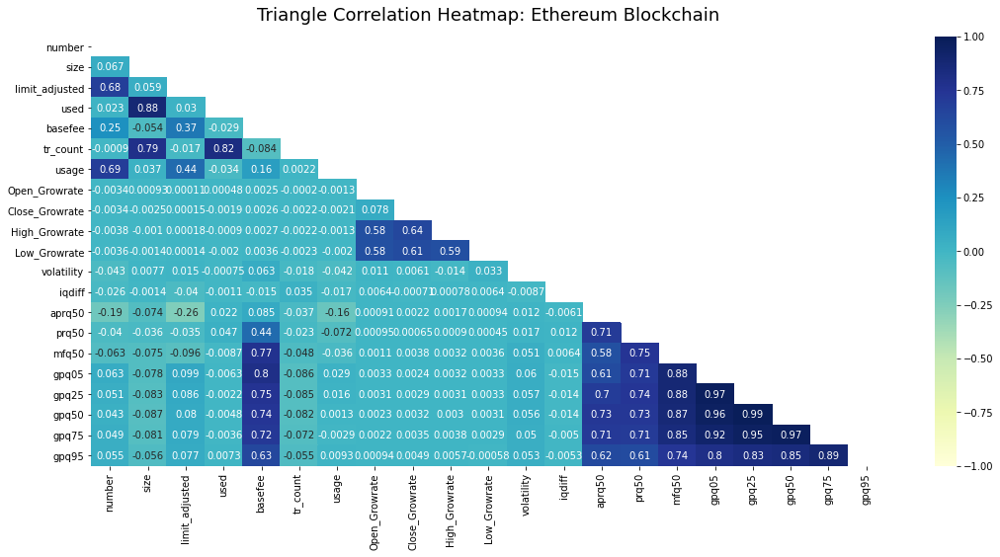

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
# Increase the size of the heatmap.
plt.figure(figsize=(18, 8))
#triangle
import numpy as np
mask = np.triu(np.ones_like(df_Heatmap.corr(), dtype=np.bool))
heatmap = sns.heatmap(df_Heatmap.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='YlGnBu') #control colors: https://www.python-graph-gallery.com/92-control-color-in-seaborn-heatmaps/#:~:text=You%20can%20customize%20the%20colors,heatmap()%20function%20in%20seaborn.&text=It%20is%20also%20possible%20to,vmin%20parameters%20in%20the%20function.
heatmap.set_title('Triangle Correlation Heatmap: Ethereum Blockchain', fontdict={'fontsize':18}, pad=16);

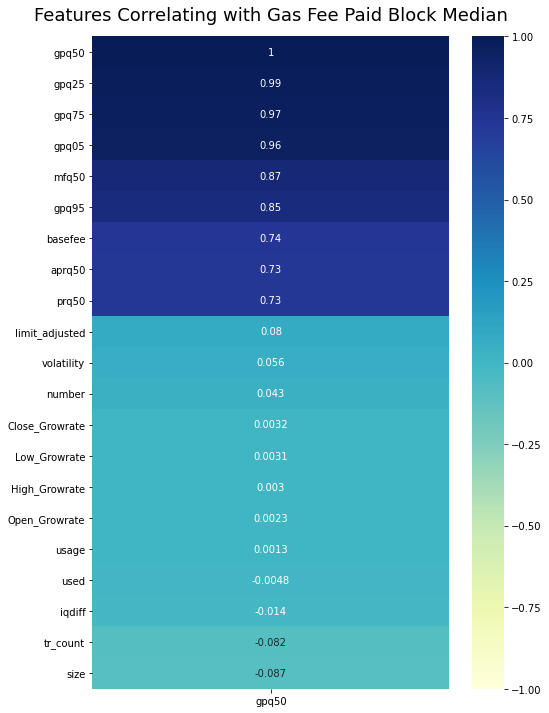

In [ ]:
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(df_Heatmap.corr()[['gpq50']].sort_values(by='gpq50', ascending=False), vmin=-1, vmax=1, annot=True, cmap='YlGnBu')
heatmap.set_title('Features Correlating with Gas Fee Paid Block Median', fontdict={'fontsize':18}, pad=16);

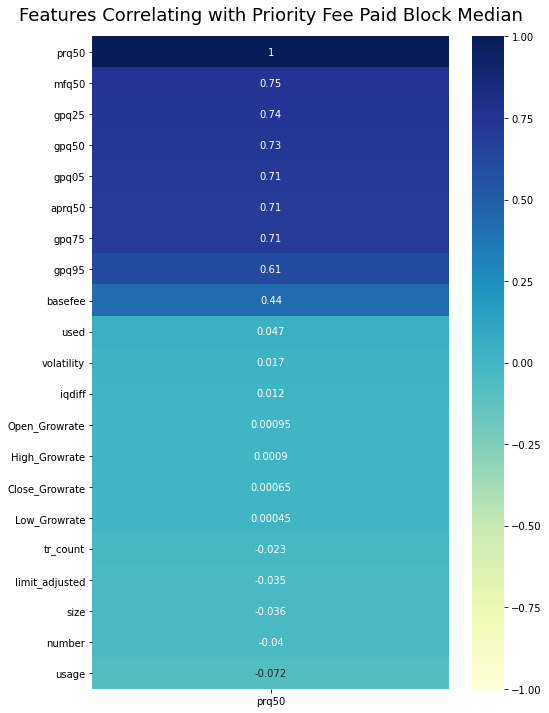

In [ ]:
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(df_Heatmap.corr()[['prq50']].sort_values(by='prq50', ascending=False), vmin=-1, vmax=1, annot=True, cmap='YlGnBu')
heatmap.set_title('Features Correlating with Priority Fee Paid Block Median', fontdict={'fontsize':18}, pad=16);

## Autocorrelation

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [ ]:
#creating a function to plot the graph and show the test result:
def auto_correlation(y, column, lags_plots=48, figsize=(22,8)):
    "Use Series as parameter"
    
    y = pd.Series(y)
    fig = plt.figure()

    ax1 = plt.subplot2grid((3, 3), (0, 0), colspan=2)
    ax2 = plt.subplot2grid((3, 3), (1, 0))
    ax3 = plt.subplot2grid((3, 3), (1, 1))

    y.plot(ax=ax1, figsize=figsize, color='teal')
    ax1.set_title(column)
    plot_acf(y, lags=lags_plots, zero=False, ax=ax2, color='teal');
    plot_pacf(y, lags=lags_plots, zero=False, ax=ax3, method='ols', color='teal');
    plt.tight_layout()
        

In [ ]:
df.columns

Index(['timestamp', 'number', 'size', 'limit', 'used', 'tr_count', 'basefee',
       'prq05', 'prq25', 'prq50', 'prq75', 'prq95', 'prcount', 'gpq05',
       'gpq25', 'gpq50', 'gpq75', 'gpq95', 'gpcount', 'mfq05', 'mfq25',
       'mfq50', 'mfq75', 'mfq95', 'mfcount', 'minute', 'EIP', 'usage', 'hour',
       'aprq05', 'aprq25', 'aprq50', 'aprq75', 'aprq95', 'iqdiff', 'open',
       'high', 'low', 'close', 'hml', 'volatility', 'limit_adjusted',
       'Open_Growrate', 'Close_Growrate', 'High_Growrate', 'Low_Growrate'],
      dtype='object')

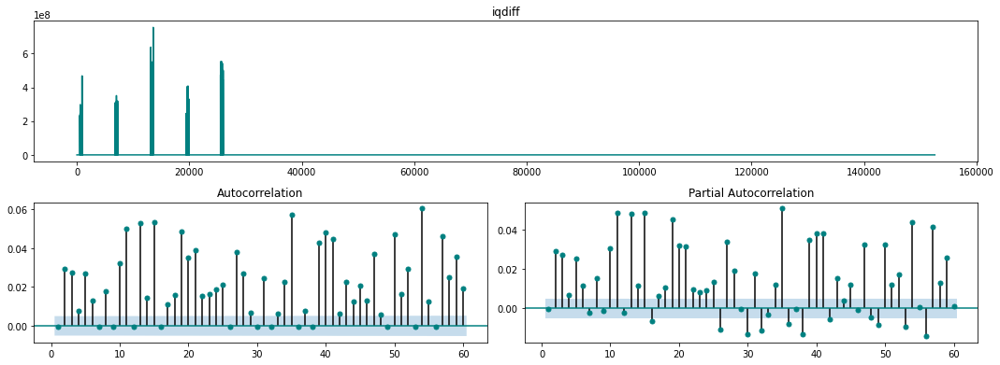

In [ ]:
## autocorrelation for iqdiff
auto_correlation(df['iqdiff'].dropna(), 'iqdiff',lags_plots=60)

In [ ]:
df.describe()

,number,size,limit,used,tr_count,basefee,prq05,prq25,prq50,prq75,prq95,prcount,gpq05,gpq25,gpq50,gpq75,gpq95,gpcount,mfq05,mfq25,mfq50,mfq75,mfq95,mfcount,EIP,usage,hour,aprq05,aprq25,aprq50,aprq75,aprq95,iqdiff,open,high,low,close,hml,volatility,limit_adjusted,Open_Growrate,Close_Growrate,High_Growrate,Low_Growrate
count,1.526020e+05,152602.000000,1.526020e+05,152602.000000,152602.000000,152602.000000,114392.000000,114392.000000,114392.000000,114392.000000,114392.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,114392.000000,114392.000000,114392.000000,114392.000000,114392.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,152602.000000,1.524990e+05,81693.000000,81693.000000,81693.000000,81693.000000,81693.000000,81664.000000,152602.000000,152601.000000,152601.000000,152601.000000,152601.000000
mean,1.301370e+07,74116.958080,2.720941e+07,15.559016,190.609278,38.049908,4.754002,7.236467,10.321385,16.770373,45.884468,40.356018,47.123266,49.466783,53.192132,61.409273,85.103856,190.609278,59.812474,71.848979,83.043042,95.270976,118.363637,40.356018,0.814616,0.211377,11.568374,9.073358,11.416876,15.142224,23.359365,47.053948,1.578474e+05,2895.001923,2897.110098,2892.883081,2895.053406,0.001461,0.003278,27.209405,0.000002,0.000002,0.000002,0.000002
std,4.469291e+04,50232.331989,5.834514e+06,9.457082,130.072817,48.693533,45.824880,54.626309,65.608180,80.584520,153.371098,69.137609,60.588883,66.542580,71.226524,81.108803,116.668184,130.072817,76.597680,83.527645,93.001508,107.627765,177.147512,69.137609,0.388610,0.233547,6.914680,36.601223,43.718123,47.999259,57.043488,93.709807,8.228329e+06,258.900225,259.071836,258.744480,258.913359,0.001011,0.002292,5.834514,0.000430,0.000429,0.000377,0.000395
min,1.293634e+07,631.000000,1.481054e+07,0.021000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.423420,1.423420,13.600616,16.000000,20.090895,0.000000,0.000000,0.000000,0.000000,-2.800000,-0.368000,-0.348000,-0.238000,0.000000,0.000000e+00,2447.875000,2452.625000,2447.200000,2448.050000,0.000043,0.000262,14.810538,-0.011379,-0.011099,-0.010673,-0.011350
25%,1.297499e+07,34402.500000,2.997068e+07,7.606691,91.000000,24.518496,0.600000,1.500000,2.000000,4.000000,6.953127,0.000000,31.132128,32.699381,35.000000,40.000000,54.000000,91.000000,37.417799,45.000000,51.502496,61.000000,70.343288,0.000000,1.000000,0.000000,6.000000,1.201635,1.979039,4.000000,8.813013,22.893783,1.065372e-01,2620.750000,2623.375000,2618.812000,2621.027100,0.000823,0.001918,29.970677,0.000000,0.000000,0.000000,0.000000
50%,1.301367e+07,66126.000000,3.000000e+07,14.974554,172.000000,35.537237,1.500000,4.000000,4.000000,5.000000,28.713702,14.000000,39.869711,41.261734,44.099958,50.278911,65.263671,172.000000,49.089272,59.084384,69.673136,80.000000,91.080699,14.000000,1.000000,0.128205,12.000000,1.765026,4.000000,6.984528,14.519924,32.000000,1.818182e-01,2954.625000,2956.530000,2952.665000,2954.738000,0.001225,0.002722,30.000000,0.000000,0.000000,0.000000,0.000000
75%,1.305240e+07,107651.500000,3.002927e+07,23.740728,270.000000,47.687335,4.000000,4.826775,6.000000,11.000000,49.500000,52.000000,51.000000,53.000000,56.708622,64.000000,87.045940,270.000000,65.846767,81.195402,94.965225,106.000000,123.700250,52.000000,1.000000,0.351120,18.000000,4.523497,7.655356,14.461014,26.250000,50.000000,2.749914e-01,3131.320100,3133.701900,3128.902100,3131.152100,0.001808,0.003953,30.029267,0.000000,0.000000,0.000000,0.000000
max,1.309119e+07,504962.000000,3.038299e+07,30.292928,1431.000000,1870.000000,5000.000000,5000.000000,8981.890000,13472.800000,25073.900000,1427.000000,2444.340000,2500.000000,2796.990000,3873.460000,5600.000000,1431.000000,5000.000000,5000.000000,9089.300000,13580.200000,25125.100000,1427.000000,1.000000,1.000000,23.000000,2180.000000,2432.299300,2562.529300,2933.04

# Regression Discontinuity

In [ ]:
#@title Normalize the number of block with London Fork as the center
### 
df['block_London_Fork'] =df['number']-12965000
df.head()

,Unnamed: 0,timestamp,number,size,limit,used,tr_count,basefee,prq05,prq25,prq50,prq75,prq95,prcount,gpq05,gpq25,gpq50,gpq75,gpq95,gpcount,mfq05,mfq25,mfq50,mfq75,mfq95,mfcount,minute,EIP,usage,hour,aprq05,aprq25,aprq50,aprq75,aprq95,iqdiff,open,high,low,close,hml,volatility,limit_adjusted,Open_Growrate,Close_Growrate,High_Growrate,Low_Growrate,block_London_Fork
0,0,2021-08-01 00:00:17,12936340,79706,14978011,14.972452,161,0.0,NaN,NaN,NaN,NaN,NaN,0,30.0,31.50028,35.000000,42.0,464.000000,161,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:00,0,0.0,0,30.0,31.50028,35.000000,42.000000,464.00000,0.299992,2532.7229,2534.7129,2531.1631,2532.988,0.001401,NaN,14.978011,NaN,NaN,NaN,NaN,-28660
1,1,2021-08-01 00:01:00,12936341,69444,14963386,14.944270,248,0.0,NaN,NaN,NaN,NaN,NaN,0,28.0,29.00000,29.000000,30.0,30.000000,248,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,28.0,29.00000,29.000000,30.000000,30.00000,0.034483,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,14.963386,0.000091,-0.003071,-0.000534,-0.002852,-28659
2,2,2021-08-01 00:01:07,12936342,61130,14970666,14.969808,181,0.0,NaN,NaN,NaN,NaN,NaN,0,33.0,35.00000,40.000000,55.8,194.000000,181,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,33.0,35.00000,40.000000,55.799999,194.00000,0.520000,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,14.970666,0.000000,0.000000,0.000000,0.000000,-28658
3,3,2021-08-01 00:01:34,12936343,72519,14985284,14.964785,157,0.0,NaN,NaN,NaN,NaN,NaN,0,30.0,31.00000,35.000000,40.0,174.290000,157,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,30.0,31.00000,35.000000,40.000000,174.28999,0.257143,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,14.985284,0.000000,0.000000,0.000000,0.000000,-28657
4,4,2021-08-01 00:01:57,12936344,59521,14970651,14.967183,177,0.0,NaN,NaN,NaN,NaN,NaN,0,35.0,36.00000,39.992858,54.0,83.496907,177,NaN,NaN,NaN,NaN,NaN,0,2021-08-01 00:01,0,0.0,0,35.0,36.00000,39.992859,54.000000,83.49691,0.450080,2532.9529,2533.3589,2523.9451,2525.210,0.003723,NaN,14.970651,0.000000,0.000000,0.000000,0.000000,-28656


In [ ]:
#@title Import regression packages

import statsmodels.api as sm
import statsmodels.formula.api as smf

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [ ]:
#@title Execute Regression 1
results1 = smf.ols('iqdiff ~ 1+ EIP + block_London_Fork', data=df).fit()

In [ ]:
#@title Execute Regression 2
results1 = smf.ols('iqdiff ~ 1+ EIP + block_London_Fork+EIP*block_London_Fork', data=df).fit()

In [ ]:
#@title Show Regression 2 result

print(results2.summary())

                            OLS Regression Results                            
Dep. Variable:                 iqdiff   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     86.15
Date:                Mon, 30 Aug 2021   Prob (F-statistic):           1.09e-55
Time:                        09:16:53   Log-Likelihood:            -2.6445e+06
No. Observations:              152499   AIC:                         5.289e+06
Df Residuals:                  152495   BIC:                         5.289e+06
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept              1.129e+

In [ ]:
#@title Execute Regression 3
results3 = smf.ols('iqdiff ~ 1+ EIP + usage', data=df).fit()

In [ ]:
#@title Show Regression 2 result
print(results3.summary())

                            OLS Regression Results                            
Dep. Variable:                 iqdiff   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     124.0
Date:                Mon, 30 Aug 2021   Prob (F-statistic):           1.63e-54
Time:                        09:16:53   Log-Likelihood:            -2.6445e+06
No. Observations:              152499   AIC:                         5.289e+06
Df Residuals:                  152496   BIC:                         5.289e+06
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    8.54e+05    4.9e+04     17.439      0.0

In [ ]:
#@title Execute Regression 4
results4 = smf.ols('iqdiff ~ 1+ EIP + EIP*usage', data=df).fit()

In [ ]:
#@title Show Regression 2 result
print(results4.summary())

                            OLS Regression Results                            
Dep. Variable:                 iqdiff   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     124.0
Date:                Mon, 30 Aug 2021   Prob (F-statistic):           1.63e-54
Time:                        09:16:53   Log-Likelihood:            -2.6445e+06
No. Observations:              152499   AIC:                         5.289e+06
Df Residuals:                  152496   BIC:                         5.289e+06
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    8.54e+05    4.9e+04     17.439      0.0

In [ ]:
#@title Install package for model comparison
!pip install stargazer

In [ ]:
#@title Import the installed packages
from stargazer.stargazer import Stargazer
from IPython.core.display import HTML

In [ ]:
#@title Model Comparison

stargazer_RD = Stargazer([results1,results2,results3,results4])
stargazer_RD.title('Regression Discontinuity')
stargazer_RD.significant_digits(2)
stargazer_RD.show_confidence_intervals(True)
stargazer_RD.covariate_order(['EIP','block_London_Fork','EIP:block_London_Fork','usage','EIP:usage','Intercept'])
HTML(stargazer_RD.render_html())

# Panel Data Analysis

In [ ]:
#@title Install package for panel regressions
pip install linearmodels

     |████████████████████████████████| 1.5 MB 28.9 MB/s 
     |████████████████████████████████| 9.5 MB 40.4 MB/s 
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


In [ ]:
#@title Import the installed packages

from linearmodels import PooledOLS
import statsmodels.api as sm

In [ ]:
#@title Define new variables for regression

df['intercept']=1
df['EIP-Usage']=df['EIP']*df["usage"]
df['EIP-basefee']=df['EIP']*df["basefee"]

In [ ]:
#@title Define Time and Entity Effect

df=df.set_index(['EIP','hour'])
df.head()

timestamp    number   size     limit       used  tr_count  \
EIP hour                                                                        
0   0     2021-08-01 00:00:17  12936340  79706  14978011  14.972452       161   
    0     2021-08-01 00:01:00  12936341  69444  14963386  14.944270       248   
    0     2021-08-01 00:01:07  12936342  61130  14970666  14.969808       181   
    0     2021-08-01 00:01:34  12936343  72519  14985284  14.964785       157   
    0     2021-08-01 00:01:57  12936344  59521  14970651  14.967183       177   

          basefee  prq05  prq25  prq50  prq75  prq95  prcount  gpq05  \
EIP hour                                                               
0   0         0.0    NaN    NaN    NaN    NaN    NaN        0   30.0   
    0         0.0    NaN    NaN    NaN    NaN    NaN        0   28.0   
    0         0.0    NaN    NaN    NaN    NaN    NaN        0   33.0   
    0         0.0    NaN    NaN    NaN    NaN    NaN        0   30.0   
    0         0.0    NaN    NaN    NaN    NaN    NaN        0   35.0   

             gpq25      gpq50  gpq75       gpq95  gpcount  mfq05  mfq25  \
EIP hour                                                                  
0   0     31.50028  35.000000   42.0  464.000000      161    NaN    NaN   
    0     29.00000  29.000000   30.0   30.000000      248    NaN    NaN   
    0     35.00000  40.000000   55.8  194.000000      181    NaN    NaN   
    0     31.00000  35.000000   40.0  174.290000      157    NaN    NaN   
    0     36.00000  39.992858   54.0   83.496907      177    NaN    NaN   

          mfq50  mfq75  mfq95  mfcount            minute  usage  aprq05  \
EIP hour                                                                  
0   0       NaN    NaN    NaN        0  2021-08-01 00:00    0.0    30.0   
    0       NaN    NaN    NaN        0  2021-08-01 00:01    0.0    28.0   
    0       NaN    NaN    NaN        0  2021-08-01 00:01    0.0    33.0   
    0       NaN    NaN    NaN        0  2021-08-01 00:01    0.0    30.0   
    0       NaN    NaN    NaN        0  2021-08-01 00:01    0.0    35.0   

            aprq25     aprq50     aprq75     aprq95    iqdiff       open  \
EIP hour                                                                   
0   0     31.50028  35.000000  42.000000  464.00000  0.299992  2532.7229   
    0     29.00000  29.000000  30.000000   30.00000  0.034483  2532.9529   
    0     35.00000  40.000000  55.799999  194.00000  0.520000  2532.9529   
    0     31.00000  35.000000  40.000000  174.28999  0.257143  2532.9529   
    0     36.00000  39.992859  54.000000   83.49691  0.450080  2532.9529   

               high        low     close       hml  volatility  intercept  \
EIP hour                                                                    
0   0     2534.7129  2531.1631  2532.988  0.001401         NaN          1   
    0     2533.3589  2523.9451  2525.210  0.003723         NaN          1   
    0     2533.3589  2523.9451  2525.210  0.003723         NaN          1   
    0     2533.3589  2523.9451  2525.210  0.003723         NaN          1   
    0     2533.3589  2523.9451  2525.210  0.003723         NaN          1   

          EIP-Usage  EIP-basefee  
EIP hour                          
0   0           0.0          0.0  
    0           0.0          0.0  
    0           0.0          0.0  
    0           0.0          0.0  
    0           0.0          0.0

In [ ]:
#@title Define variables for regression

exog=df[["size","intercept","EIP-Usage","EIP-basefee"]]
endog = df["iqdiff"]

## Pooled OLS

In [ ]:
mod = PooledOLS(endog, exog)
pooled_res=mod.fit()

/usr/local/lib/python3.7/dist-packages/linearmodels/shared/exceptions.py:35: MissingValueWarning: 
Inputs contain missing values. Dropping rows with missing observations.
  warnings.warn(missing_value_warning_msg, MissingValueWarning)


In [ ]:
print(pooled_res)

                          PooledOLS Estimation Summary                          
Dep. Variable:                 iqdiff   R-squared:                        0.0005
Estimator:                  PooledOLS   R-squared (Between):              0.2815
No. Observations:              152499   R-squared (Within):              -0.0003
Date:                Mon, Aug 30 2021   R-squared (Overall):              0.0005
Time:                        09:55:26   Log-likelihood                -2.645e+06
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                      23.277
Entities:                           2   P-value                           0.0000
Avg Obs:                    7.625e+04   Distribution:                F(3,152495)
Min Obs:                    2.819e+04                                           
Max Obs:                    1.243e+05   F-statistic (robust):             23.277
                            

## Fixed Effect: Entity

In [ ]:
from linearmodels import PanelOLS

In [ ]:
model_fe_entity = PanelOLS(endog, exog, entity_effects = True) 
fe_entity_res = model_fe_entity.fit()

/usr/local/lib/python3.7/dist-packages/linearmodels/shared/exceptions.py:35: MissingValueWarning: 
Inputs contain missing values. Dropping rows with missing observations.
  warnings.warn(missing_value_warning_msg, MissingValueWarning)


In [ ]:
print(fe_entity_res )

                          PanelOLS Estimation Summary                           
Dep. Variable:                 iqdiff   R-squared:                     9.563e-07
Estimator:                   PanelOLS   R-squared (Between):             -0.4031
No. Observations:              152499   R-squared (Within):            9.563e-07
Date:                Mon, Aug 30 2021   R-squared (Overall):          -5.758e-06
Time:                        09:55:44   Log-likelihood                -2.645e+06
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                      0.0486
Entities:                           2   P-value                           0.9858
Avg Obs:                    7.625e+04   Distribution:                F(3,152494)
Min Obs:                    2.819e+04                                           
Max Obs:                    1.243e+05   F-statistic (robust):             0.0486
                            

## Fixed Effect: Time

In [ ]:
model_fe_time = PanelOLS(endog, exog, time_effects = True) 
fe_time_res = model_fe_time.fit()

/usr/local/lib/python3.7/dist-packages/linearmodels/shared/exceptions.py:35: MissingValueWarning: 
Inputs contain missing values. Dropping rows with missing observations.
  warnings.warn(missing_value_warning_msg, MissingValueWarning)


In [ ]:
print(fe_time_res)

                          PanelOLS Estimation Summary                           
Dep. Variable:                 iqdiff   R-squared:                        0.0005
Estimator:                   PanelOLS   R-squared (Between):              0.2956
No. Observations:              152499   R-squared (Within):              -0.0004
Date:                Mon, Aug 30 2021   R-squared (Overall):              0.0004
Time:                        09:55:49   Log-likelihood                -2.644e+06
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                      24.073
Entities:                           2   P-value                           0.0000
Avg Obs:                    7.625e+04   Distribution:                F(3,152472)
Min Obs:                    2.819e+04                                           
Max Obs:                    1.243e+05   F-statistic (robust):             24.073
                            

## Fixed Effect: Both

In [ ]:
model_fe = PanelOLS(endog, exog, time_effects = True, entity_effects = True ) 
fe_res = model_fe.fit()

/usr/local/lib/python3.7/dist-packages/linearmodels/shared/exceptions.py:35: MissingValueWarning: 
Inputs contain missing values. Dropping rows with missing observations.
  warnings.warn(missing_value_warning_msg, MissingValueWarning)


In [ ]:
print(fe_res)

                          PanelOLS Estimation Summary                           
Dep. Variable:                 iqdiff   R-squared:                     7.816e-06
Estimator:                   PanelOLS   R-squared (Between):             -0.3750
No. Observations:              152499   R-squared (Within):           -8.744e-06
Date:                Mon, Aug 30 2021   R-squared (Overall):           1.723e-05
Time:                        09:55:56   Log-likelihood                -2.644e+06
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                      0.3972
Entities:                           2   P-value                           0.7550
Avg Obs:                    7.625e+04   Distribution:                F(3,152471)
Min Obs:                    2.819e+04                                           
Max Obs:                    1.243e+05   F-statistic (robust):             0.3972
                            

In [ ]:
model_fe = PanelOLS(endog, exog, time_effects = True, entity_effects = True ) 
clust_fe= model_fe.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)

/usr/local/lib/python3.7/dist-packages/linearmodels/shared/exceptions.py:35: MissingValueWarning: 
Inputs contain missing values. Dropping rows with missing observations.
  warnings.warn(missing_value_warning_msg, MissingValueWarning)


In [ ]:
print(clust_fe)

                          PanelOLS Estimation Summary                           
Dep. Variable:                 iqdiff   R-squared:                     7.816e-06
Estimator:                   PanelOLS   R-squared (Between):             -0.3750
No. Observations:              152499   R-squared (Within):           -8.744e-06
Date:                Mon, Aug 30 2021   R-squared (Overall):           1.723e-05
Time:                        09:56:02   Log-likelihood                -2.644e+06
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      0.3972
Entities:                           2   P-value                           0.7550
Avg Obs:                    7.625e+04   Distribution:                F(3,152471)
Min Obs:                    2.819e+04                                           
Max Obs:                    1.243e+05   F-statistic (robust):             0.2638
                            

/usr/local/lib/python3.7/dist-packages/linearmodels/panel/results.py:85: RuntimeWarning: invalid value encountered in sqrt
  return Series(np.sqrt(np.diag(self.cov)), self._var_names, name="std_error")


## Random Effect

In [ ]:
from linearmodels import RandomEffects
model_re = RandomEffects(endog, exog) 
re_res= model_re.fit()

/usr/local/lib/python3.7/dist-packages/linearmodels/shared/exceptions.py:35: MissingValueWarning: 
Inputs contain missing values. Dropping rows with missing observations.
  warnings.warn(missing_value_warning_msg, MissingValueWarning)


In [ ]:
print(re_res)

                        RandomEffects Estimation Summary                        
Dep. Variable:                 iqdiff   R-squared:                        0.0005
Estimator:              RandomEffects   R-squared (Between):              0.2815
No. Observations:              152499   R-squared (Within):              -0.0003
Date:                Mon, Aug 30 2021   R-squared (Overall):              0.0005
Time:                        09:56:07   Log-likelihood                -2.645e+06
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                      23.277
Entities:                           2   P-value                           0.0000
Avg Obs:                    7.625e+04   Distribution:                F(3,152495)
Min Obs:                    2.819e+04                                           
Max Obs:                    1.243e+05   F-statistic (robust):             23.277
                            

## Model Comparison

In [ ]:
from linearmodels.panel import compare
print(compare({'Pooled':pooled_res,'Fixed Effect: Entity':fe_entity_res ,'Fixed Effect:Time':fe_time_res, 'Fixed Effect:Both':fe_res,'Fixed Effect:Cluster': clust_fe, 'Random Effect':re_res},stars = True))

                                                             Model Comparison                                                            
                                   Pooled Fixed Effect: Entity Fixed Effect:Time Fixed Effect:Both Fixed Effect:Cluster     Random Effect
-----------------------------------------------------------------------------------------------------------------------------------------
Dep. Variable                      iqdiff               iqdiff            iqdiff            iqdiff               iqdiff            iqdiff
Estimator                       PooledOLS             PanelOLS          PanelOLS          PanelOLS             PanelOLS     RandomEffects
No. Observations                   152499               152499            152499            152499               152499            152499
Cov. Est.                      Unadjusted           Unadjusted        Unadjusted        Unadjusted            Clustered        Unadjusted
R-squared                         

/usr/local/lib/python3.7/dist-packages/linearmodels/panel/results.py:85: RuntimeWarning: invalid value encountered in sqrt
  return Series(np.sqrt(np.diag(self.cov)), self._var_names, name="std_error")
